In [1]:
from astropy.table import Table
from dendrocat import RadioSource
from astropy.io import fits
from spectral_cube import SpectralCube
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import numpy as np
import sys
import importlib
from astropy.wcs import WCS
from scipy import interpolate
import pandas as pd
import sympy as syp
from astropy import units as u
import radio_beam
from astropy.table import Table
from radio_beam import Beam
from astropy import coordinates
from astropy import wcs
from astropy.nddata.utils import Cutout2D
from dendrocat.aperture import Ellipse

W51 = '/orange/adamginsburg/w51/TaehwaYoo/'
W51b6 = '/orange/adamginsburg/w51/TaehwaYoo/2015.1.01596.S_W51_B6_LB/continuum_images/'
W51cont='/orange/adamginsburg/w51/TaehwaYoo/b6contfits/'
w51e2_b6_briggs=W51cont+'W51e2_cont_bigbriggs.image.fits'
w51e2_b6_robust0=W51cont+'W51e2_cont_big_robust0.image.fits'
w51e2_b6_uniform=W51cont+'W51e2_cont_biguniform.image.fits'
w51e2_b6_superuniform=W51cont+'W51e2_cont_bigsuperuniform.image.fits'

w51n_b6_briggs = W51cont+'W51n_cont_bigbriggs.image.fits'
w51n_b6_robust0 = W51cont+'w51n_cont_big_robust0.image.fits'
w51n_b6_uniform = W51cont+'W51n_cont_biguniform.image.fits'
w51n_b6_superuniform = W51cont+'W51n_cont_bigsuperuniform.image.fits'
w51n_b6_natural = W51cont+'W51n_cont_bignatural.image.fits'

W51b3 = '/orange/adamginsburg/w51/TaehwaYoo/2017.1.00293.S_W51_B3_LB/may2021_successful_imaging/'

w51n_b3_tt0 = W51b3+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'
w51n_b3_tt1 = W51+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt1.pbcor.fits'
w51n_b3_alpha = W51+'w51n.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.alpha.pbcor.fits'

w51conv = '/orange/adamginsburg/w51/TaehwaYoo/convolved_new/'
w51n_b6_conv = w51conv + 'w51n_cont_bigbriggs.image.convB3_briggs.fits'

w51e_b3_tt0 = W51b3+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'
w51e2_b3_tt1 = W51+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt1.pbcor.fits'
w51e2_b3_alpha = W51+'w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.alpha.pbcor.fits'

w51e2_b6_conv = w51conv + 'w51e2_cont_bigbriggs.image.convB3_briggs.fits'

w51e_b6_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51e_B6_conv.fits'
w51e_b3_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51e_B3_conv.fits'


w51n_b3_almaimf_conv = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/w51n_B3_conv.fits'

w51n_b6_almaimf = '/orange/adamginsburg/w51/TaehwaYoo/w51_alma_imf/W51-IRS2_B6_uid___A001_X1296_X187_continuum_merged_12M_robust0_selfcal9_finaliter.image.tt0.pbcor.fits'

w51n_b6_conv_briggs = w51conv + 'w51n_briggs_B6_conv.fits'
w51n_b6_conv_robust0 = w51conv + 'w51n_robust0_B6_conv.fits'
w51n_b6_conv_superuniform = w51conv + 'w51n_superuniform_B6_conv.fits'

w51e_b6_conv_briggs = w51conv + 'w51e_briggs_B6_conv.fits'
w51e_b6_conv_robust0 = w51conv + 'w51e_robust0_B6_conv.fits'
w51n_b6_conv_superuniform = w51conv + 'w51e_superuniform_B6_conv.fits'
#----------

#w51e_b3_tt0 = '/Users/dbahck37/W51data/w51e2.spw0thru19.14500.robust0.thr0.075mJy.mfs.I.startmod.selfcal7.image.tt0.pbcor.fits'

#w51e_b6_conv_briggs ='/Users/dbahck37/W51data/convolved_new/w51e_briggs_B6_conv.fits'





In [2]:
def measure_alpha_peak_matching(b3data, b6data, tb3, tb6, b3ind, b6ind,  save=True, savedir=None):
    peakx_b6 = list(tb6['peak_x'])
    peaky_b6 = list(tb6['peak_y'])
    peakxy_b6 = np.vstack((peakx_b6,peaky_b6)).T


    peakx_b3 = list(tb3['peak_x'])
    peaky_b3 = list(tb3['peak_y'])
    peakxy_b3 = np.vstack((peakx_b3,peaky_b3)).T

    fitsdata_b3 = fits.open(b3data)
    imageb3 = fitsdata_b3[0].data
    if len(imageb3.shape)!=2:
        imageb3 = imageb3[0][0]
    
    fitsdata_b6 = fits.open(b6data)
    imageb6 = fitsdata_b6[0].data
    if len(imageb6.shape)!=2:
        imageb6 = imageb6[0][0]

    hdrNB6 = fits.getheader(b6data)  
    hdrNB3 = fits.getheader(b3data)  
    wcsNB3 = WCS(hdrNB3,naxis=2)
    wcsNB6 = WCS(hdrNB6,naxis=2)
    
    my_beamNB6 = Beam.from_fits_header(hdrNB6)
    my_beamNB3 = Beam.from_fits_header(hdrNB3)


    scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
    scaleNB6 = wcsNB6.proj_plane_pixel_scales()[0]

    scaleNB3_sr = (scaleNB3 * np.pi/180)**2
    scaleNB6_sr = (scaleNB6 * np.pi/180)**2


    
    
    

    B6flux = get_flux(imageb6,peakxy_b6[b6ind], my_beamNB6,  wcsNB6, scaleNB6)
    B3flux = get_flux(imageb3,peakxy_b3[b3ind], my_beamNB3,  wcsNB3, scaleNB3)
  
    freqb3 = cen_freq(hdrNB3['CRVAL3'],hdrNB3['CDELT4'])

    freqb6 = cen_freq(hdrNB6['CRVAL4'],hdrNB6['CDELT4'])
    alpha = np.log10(B3flux/B6flux)/np.log10(freqb3/freqb6)
    print(alpha)
    
    return alpha

def get_flux(data,peakxy, beam1, wcsNB, pixel_scale, issky=False,savedir=None):
    fluxarr = []

    if issky:
        print(issky)
        cen_world = peakxy
    else:
        print(issky)
        cen_world = wcsNB.wcs_pix2world(peakxy,0)
    num_source = len(cen_world)
    print('cen_world',cen_world,len(cen_world))
    print(num_source)
    
    for i in range(num_source):
        
        #x_cen = peakxy[i][0]
        #y_cen = peakxy[i][1]
        #cen = (x_cen, y_cen)
        major = beam1.major
        minor = beam1.minor
        pa = beam1.pa
        print(major)
        print(type(major))

        positions = coordinates.SkyCoord(cen_world[i,0],cen_world[i,1], frame=wcs.utils.wcs_to_celestial_frame(wcsNB).name,unit=(u.deg,u.deg))
        cutout = Cutout2D(data, positions, 4.0*major, wcs=wcsNB, mode='partial')
        frame = wcs.utils.wcs_to_celestial_frame(cutout.wcs).name
        aperture = Ellipse(positions, major, minor, -1*pa, unit=u.deg, frame=frame) # pa in degree with anti-clockwise direction
        this_mask = aperture.place(cutout.data, wcs=cutout.wcs)
        pixel_scale_sr = (pixel_scale.value * np.pi/180)**2 # pixel scale in deg^2 -> sr
        fluxarr.append(np.sum(cutout.data[this_mask]/beam1.sr.value*pixel_scale_sr)) # Jy/beam / (sr/beam) * (sr/pixel) = Jy/ pixel
        if savedir is not None:
            fig = plt.figure(figsize=(10,10))
            ax1=fig.add_axes([0.2,0.2,0.8,0.8],projection=wcsNB)
            ax1.imshow(cutout.data, origin='lower')
            ax1.imshow(this_mask, origin='lower',alpha=0.1,cmap='gray')
            plt.savefig(savedir+'aper_%04d.png'%i)
            plt.close()
    return np.array(fluxarr) 

def cen_freq(center, delta ,alpha=2):
    start = center-delta/2 ; end = center+delta/2
    freqarr = np.logspace(np.log10(start),np.log10(end),20)
    dfreq = freqarr[1:]-freqarr[:-1]
    dfreq = np.append(dfreq,[dfreq[-1]])
    
    integral_up = np.sum(freqarr**(alpha+1)*dfreq)
    integral_down = np.sum(freqarr**(alpha)*dfreq)
    return integral_up/integral_down






def alpha_from_skycoord_match(b3data, b6data, xpos, ypos, error=None, isb3=True):
  
    fitsdata_b3 = fits.open(b3data)
    imageb3 = fitsdata_b3[0].data
    if len(imageb3.shape)!=2:
        imageb3 = imageb3[0][0]
    
    fitsdata_b6 = fits.open(b6data)
    imageb6 = fitsdata_b6[0].data
    if len(imageb6.shape)!=2:
        imageb6 = imageb6[0][0]
        
  
    hdrNB6 = fits.getheader(b6data)  
    hdrNB3 = fits.getheader(b3data)  
    wcsNB3 = WCS(hdrNB3,naxis=2)
    wcsNB6 = WCS(hdrNB6,naxis=2)
    
    my_beamNB6 = Beam.from_fits_header(hdrNB6)
    my_beamNB3 = Beam.from_fits_header(hdrNB3)


    scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
    scaleNB6 = wcsNB6.proj_plane_pixel_scales()[0]
    
    if type(xpos) is not list:
        num_source = 1
    else:
        num_source = len(xpos)

    if isb3:
        peakxy_b3 = np.vstack((xpos,ypos)).T
        B3flux = get_flux(imageb3,peakxy_b3, my_beamNB3, wcsNB3,scaleNB3)
        peaksky = wcsNB3.pixel_to_world(xpos,ypos)
        peaksky_ra = [] ; peaksky_dec = []

        for i in range(num_source):
            if num_source==1:
                peaksky_ra.append(peaksky.ra.degree)
                peaksky_dec.append(peaksky.dec.degree)
            else:
                peaksky_ra.append(peaksky[i].ra.degree)
                peaksky_dec.append(peaksky[i].dec.degree)
        peaksky_arr = np.vstack((peaksky_ra,peaksky_dec)).T
        B6flux = get_flux(imageb6,peaksky_arr, my_beamNB6, wcsNB6,scaleNB6,issky=True)
        lowind = np.where(B6flux < error)[0]
        B6flux[lowind] = error
    else:
        peakxy_b6 = np.vstack((xpos,ypos)).T
        B6flux = get_flux(imageb6,peakxy_b6, my_beamNB6, wcsNB6,scaleNB6)
        peaksky = wcsNB6.pixel_to_world(xpos,ypos)
        peaksky_ra = [] ; peaksky_dec = []
        for i in range(num_source):
            if num_source==1:
                peaksky_ra.append(peaksky.ra.degree)
                peaksky_dec.append(peaksky.dec.degree)
            else:
                peaksky_ra.append(peaksky[i].ra.degree)
                peaksky_dec.append(peaksky[i].dec.degree)
        peaksky_arr = np.vstack((peaksky_ra,peaksky_dec)).T
        B3flux = get_flux(imageb3,peaksky_arr, my_beamNB3, wcsNB3,scaleNB3,issky=True)
        lowind = np.where(B3flux < error)[0]
        B3flux[lowind] = error
    freqb3 = cen_freq(hdrNB3['CRVAL3'],hdrNB3['CDELT4'])
    freqb6 = cen_freq(hdrNB6['CRVAL4'],hdrNB6['CDELT4'])
    alpha = np.log10(B3flux/B6flux)/np.log10(freqb3/freqb6)
    
    print(B3flux, B6flux, freqb3,freqb6)
    print(alpha)

    
    return alpha





matching_index
--------------
        930000
            -1
        930008
        930014
        930015
        930016
           ...
        930307
            -1
        930308
        930310
        930311
        930314
Length = 66 rows
[0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15, 16, 17, 18, 19, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 44, 45, 46, 47, 48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 62, 63, 64, 65]
[0, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15, 16, 17, 18, 19, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 44, 45, 46, 47, 48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 62, 63, 64, 65] [0, 6, 10, 11, 12, 14, 16, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33, 35, 37, 38, 39, 40, 44, 46, 47, 48, 51, 53, 54, 56, 57, 58, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 74, 75, 77, 78, 79, 80, 81, 82, 83, 86]
[ 1.09391098e-01  9.37632135e-02  9.37634519e-02  9.37632940e-02
  1.25019841e-01 -5.73095310e-06  7.81

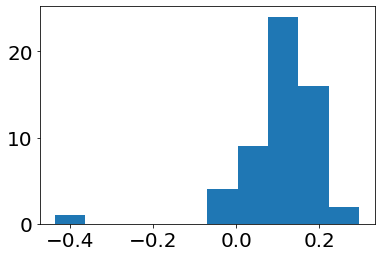

In [3]:
plt.rcParams['axes.labelsize']=20
plt.rcParams['xtick.labelsize']=20
plt.rcParams['ytick.labelsize']=20
plt.rcParams['axes.titlesize']=20
#w51e_b3 = Table.read('/Users/dbahck37/w51_jupyter/w51/catalogue/dendrogram/dendro_w51e_b3.fits',format='fits')
#w51e_b6 = Table.read('/Users/dbahck37/w51_jupyter/w51/catalogue/dendrogram/dendro_w51e_b6_briggs.fits',format='fits')
w51e_b3 = Table.read('/home/t.yoo/w51/catalogue/dendrogram/dendro_w51e_b3.fits',format='fits')
w51e_b6 = Table.read('/home/t.yoo/w51/catalogue/dendrogram/dendro_w51e_b6_briggs.fits',format='fits')
b6matind_table = w51e_b6['matching_index']
b3matind_table = w51e_b3['matching_index']
b6indic = w51e_b6['_name']
b3indic = w51e_b3['_name']
b6matched = [i for i in range(len(b6matind_table)) if int(b6matind_table[i])>0]
b6matind_table_matched = b6matind_table[b6matched]

b3matched = [i for i in range(len(b3matind_table)) if int(b3matind_table[i])>0]
b3matind_table_matched = b3matind_table[b3matched]
print(b6matind_table)
b3matchindlist=[]
for ind in b6matind_table_matched:
    b3matchind = np.where(ind==b3indic)[0]
    b3matchindlist.append(b3matchind.item())
# find unselected index
"""
b3_unselected = list(np.arange(len(b3indic)))
for ind in b3matchindlist:
    b3_unselected.remove(ind)
"""

b3_unselected = [i for i in range(len(b3matind_table)) if int(b3matind_table[i])<0]

b6matchindlist = []

for ind in b3matind_table_matched:
    b6matchind = np.where(ind==b6indic)[0]

    b6matchindlist.append(b6matchind.item())
print(b6matchindlist)

# find unselected index
"""
b6_unselected = list(np.arange(len(b6indic)))
for ind in b6matchindlist:
    b6_unselected.remove(ind)
"""
b6_unselected = [i for i in range(len(b6matind_table)) if int(b6matind_table[i])<0]




hdrNB6 = fits.getheader(w51e_b6_conv_briggs)  
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
wcsNB6 = WCS(hdrNB6,naxis=2)


peakx_b6 = list(w51e_b6['peak_x'])
peaky_b6 = list(w51e_b6['peak_y'])
peakxy_b6 = np.vstack((peakx_b6,peaky_b6)).T

cen_world_b6 = wcsNB6.wcs_pix2world(peakxy_b6,0)



peakx_b3 = list(w51e_b3['peak_x'])
peaky_b3 = list(w51e_b3['peak_y'])
peakxy_b3 = np.vstack((peakx_b3,peaky_b3)).T

cen_world_b3 = wcsNB3.wcs_pix2world(peakxy_b3,0)
print(b6matched, b3matchindlist)
radiff = cen_world_b6[b6matched,0] - cen_world_b3[b3matchindlist,0]
decdiff = cen_world_b6[b6matched,1] - cen_world_b3[b3matchindlist,1]

my_beamNB3 = Beam.from_fits_header(hdrNB3)
#b3tob6ind=np.array([0,1,2,3,4,5,8,7,9,6,10,11,12,13,14,16,17,18,15,20,19,21])
plt.hist(radiff/my_beamNB3.major.value)
print(radiff/my_beamNB3.major.value)



(array([ 4.,  4.,  7.,  9.,  9., 11.,  6.,  2.,  3.,  1.]),
 array([-0.06052047, -0.01966957,  0.02118133,  0.06203224,  0.10288314,
         0.14373404,  0.18458495,  0.22543585,  0.26628675,  0.30713766,
         0.34798856]),
 <BarContainer object of 10 artists>)

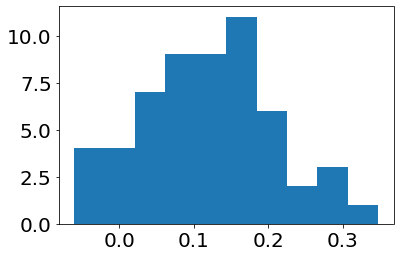

In [4]:
plt.hist(decdiff/my_beamNB3.major.value)

False
cen_world [[290.93232567  14.50541111]
 [290.93225106  14.50594167]
 [290.93236153  14.50620555]
 [290.93248204  14.50622083]
 [290.93243039  14.50623472]
 [290.93257672  14.50649722]
 [290.93262837  14.50699167]
 [290.93340737  14.50702361]
 [290.93371725  14.50703333]
 [290.9327331   14.50711944]
 [290.93331699  14.50714444]
 [290.9332553   14.50725972]
 [290.93278044  14.50727361]
 [290.93268001  14.50734306]
 [290.93348484  14.5073625 ]
 [290.93274888  14.50737778]
 [290.93280913  14.50742222]
 [290.93346906  14.50754583]
 [290.93274457  14.50756528]
 [290.93288947  14.50758194]
 [290.93291243  14.50763889]
 [290.93287512  14.50773611]
 [290.93283926  14.50780139]
 [290.93295403  14.50781667]
 [290.93293251  14.50784861]
 [290.93283782  14.50789583]
 [290.93203586  14.50896944]
 [290.93330265  14.50920556]
 [290.93388655  14.50927222]
 [290.93365127  14.50930833]
 [290.93315918  14.50950694]
 [290.93297985  14.50961111]
 [290.93294399  14.5095625 ]
 [290.93319075  14.50958333

Text(0.5, 0, 'spectral index')

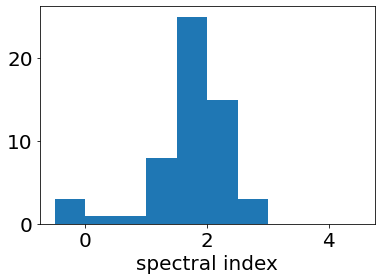

In [5]:

alpha = measure_alpha_peak_matching(w51e_b3_tt0, w51e_b6_conv_briggs,w51e_b3,w51e_b6, b3matchindlist,b6matched)
print(len(alpha))
plt.hist(alpha, bins=np.linspace(-0.5,4.5, num=11))
plt.xlabel('spectral index')



In [6]:
def save_matched_catalog(b3data,b6data,peakx_b3,peaky_b3,
                         peakx_b6,peaky_b6,
                         b3unselected, b6unselected,b3ind,b6ind,B3error,B6error,alpha):
    
    xpos_unselected_b3 = np.array(peakx_b3)[b3unselected] 
    ypos_unselected_b3 = np.array(peaky_b3)[b3unselected]
    
    xpos_unselected_b6 = np.array(peakx_b6)[b6unselected] 
    ypos_unselected_b6 = np.array(peaky_b6)[b6unselected]

    x_pix_b3 = np.array(peakx_b3)[b3ind]
    x_pix_b3 = list(x_pix_b3)
    x_pix_b3 = x_pix_b3+list(xpos_unselected_b3)
    y_pix_b3 = np.array(peaky_b3)[b3ind]
    y_pix_b3 = list(y_pix_b3)
    y_pix_b3 = y_pix_b3 + list(ypos_unselected_b3)
    

    xy_pix_b3 = np.vstack((x_pix_b3,y_pix_b3)).T
    xy_sky_b3 = wcsNB3.wcs_pix2world(xy_pix_b3,0)
    x_sky_b3 = xy_sky_b3[:,0]
    y_sky_b3 = xy_sky_b3[:,1]
    
    ismatched_b3 = np.ones(len(b3ind),dtype=bool)
    ismatched_b3 = np.append(ismatched_b3, np.zeros(len(b3unselected),dtype=bool))
    ismatched_b3 = list(ismatched_b3)

    x_pix_b6 = np.array(peakx_b6)[b6ind]
    x_pix_b6 = list(x_pix_b6)
    x_pix_b6 = x_pix_b6 +list(xpos_unselected_b6)

    y_pix_b6 = np.array(peaky_b6)[b6ind]
    y_pix_b6 = list(y_pix_b6)
    y_pix_b6 = y_pix_b6 + list(ypos_unselected_b6)

    xy_pix_b6 = np.vstack((x_pix_b6,y_pix_b6)).T
    xy_sky_b6 = wcsNB6.wcs_pix2world(xy_pix_b6,0)
    x_sky_b6 = xy_sky_b6[:,0]
    y_sky_b6 = xy_sky_b6[:,1]
    
    ismatched_b6 = np.ones(len(b6ind),dtype=bool)
    ismatched_b6 = np.append(ismatched_b6, np.zeros(len(b6unselected),dtype=bool))
    ismatched_b6 = list(ismatched_b6)
    
    x_sky_b3 = list(x_sky_b3)
    y_sky_b3 = list(y_sky_b3)
    x_sky_b6 = list(x_sky_b6)
    y_sky_b6 = list(y_sky_b6)

    """
    for i in range(len(b3unselected)):
        x_pix_b3.append(-99)
        y_pix_b3.append(-99)
        x_sky_b3.append(-99)
        y_sky_b3.append(-99)
    
    for i in range(len(b6unselected)):  
        x_pix_b6.append(-99)
        y_pix_b6.append(-99)
        x_sky_b6.append(-99)
        y_sky_b6.append(-99)
    """



    alpha_unselected_b3 = alpha_from_skycoord_match(b3data,b6data, xpos_unselected_b3, ypos_unselected_b3, error=B3error, isb3=True)
    alpha_unselected_b6 = alpha_from_skycoord_match(b3data,b6data, xpos_unselected_b6, ypos_unselected_b6, error=B6error, isb3=False)
  
    
   
    alpha_b3 = np.append(alpha, alpha_unselected_b3)
    alpha_b6 = np.append(alpha, alpha_unselected_b6)
    table_b3 = Table([x_sky_b3,y_sky_b3,
                           x_pix_b3,y_pix_b3,
                           alpha_b3, ismatched_b3],
                          names=['x_sky_b3','y_sky_b3',
                                         'x_pix_b3','y_pix_b3',
                                         'alpha','ismatched_b3'])
    
    table_b6 = Table([x_sky_b6,y_sky_b6,
                           x_pix_b6,y_pix_b6,
                           alpha_b6, ismatched_b6],
                          names=['x_sky_b6','y_sky_b6',
                                         'x_pix_b6','y_pix_b6',
                                         'alpha','ismatched_b6'])
    print(alpha_unselected_b3)
    print(alpha_unselected_b6)
    
    
    table_b6.write('w51e_b6_catalog.fits',format='fits',overwrite=True)
    table_b3.write('w51e_b3_catalog.fits',format='fits',overwrite=True)

    
    return table_b3, table_b6
    #table_matched.write('w51n_catalog.fits',format='fits')


table_b3, table_b6 = save_matched_catalog(w51e_b3_tt0,w51e_b6_conv_briggs,peakx_b3,peaky_b3,
                         peakx_b6,peaky_b6,
                         b3_unselected,b6_unselected,b3matchindlist,b6matched,
                                          2.065537678896079e-05,0.00022818539454139218,
                                          alpha)



False
cen_world [[290.93245421  14.50545778]
 [290.93236985  14.50546167]
 [290.93246425  14.5055025 ]
 [290.93233169  14.50563278]
 [290.93260484  14.50587389]
 [290.93258476  14.50593222]
 [290.93261087  14.5059575 ]
 [290.93127523  14.50606249]
 [290.93261087  14.50649806]
 [290.93264501  14.50686361]
 [290.93260283  14.50701528]
 [290.9334243   14.5070425 ]
 [290.93271932  14.50735944]
 [290.93294227  14.50771139]
 [290.93295231  14.50778139]
 [290.93296637  14.50816639]
 [290.93231361  14.50839194]
 [290.93352272  14.50883528]
 [290.93345242  14.50896944]
 [290.93312303  14.50948083]
 [290.93287398  14.5094925 ]
 [290.93286393  14.50951194]
 [290.93312504  14.50956833]
 [290.93316119  14.50963056]
 [290.93312102  14.50962472]
 [290.93323551  14.50964028]
 [290.93242206  14.50967139]
 [290.93278761  14.51001944]
 [290.93283983  14.51010889]
 [290.93249236  14.5104025 ]
 [290.93180745  14.51076027]] 31
31
1.83594537278e-05 deg
<class 'astropy.units.quantity.Quantity'>
1.83594537278e

87 31 10


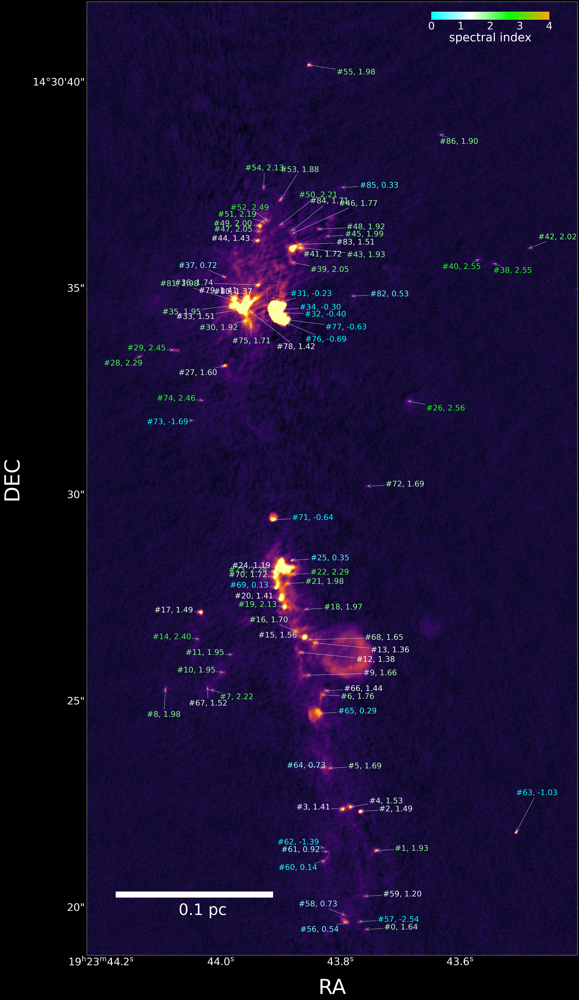

In [22]:
plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
import matplotlib as mpl 
import matplotlib.cm as cm
import matplotlib.colors
from matplotlib.patches import Rectangle, Ellipse
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

plt.style.use('dark_background')

def plot_peak(ax,image,xpos,ypos,size=20,labelind=None,labeltext=None,xtextpos=None,ytextpos=None,boxcolor=None,mark=False):
    cmap = cm.YlGn
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ['cyan',"w","lime","orange"])
    norm = mpl.colors.Normalize(vmin=0, vmax=4)
    
    
    if mark:
        ax.scatter(xpos,ypos, marker='x', c='cyan',s=size)
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    for i in range(len(labelind)):
        if boxcolor is not None:
            ss=ax.annotate("#%d, %3.2f"%(i,labelind[i]),bbox=dict(facecolor='none',edgecolor=boxcolor),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
        else:
            
            ss=ax.annotate("#%d, %3.2f"%(i,labelind[i]),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
    
    return m
def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+0.4*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))

xtextpos = np.array([100,100,100,-250,100, #4
100,100,50,-100,300, #9
-250,-250,300,300,-250, #14
-250,-250,-250,100,-250, #19
-250,100,100,-250,-250, #24
100,100,-250,-200,-250, #29
-250,100,150,-350,100,  #34
-400,-450,-250,0,100,   #39
-200,50,50,250,-250,    #44
100,250,-250,150,-250,  #49
100,-250,-200,0,-100,   #54
150,-250, 100, -250,100,#59
-250,-250,-250,0,-200,  #64
100,100,-100,300,-250,  #69
-250,100,100,-250,-250, #74
-100,100,200,140,-250,  #79
-200,-400,100,200,100,  #84
100,0,-250,-250,-250,   #89
200,250,100,100,90,     #94
-250,100]) #96
ytextpos = np.array([0,0,0,0,20, #4
0,-20,-50,-150,0, #9
0,0,-50,-50,0, #14
0,50,0,0,0, #19
0,0,0,0,0, #24
0,-50,-50,-50,0, #29
-50,50,-20,-50,0, #34
-50,0,50,-50,-50,  #39
-50,-50,50,-50,0, #44
0,150,0,0,0,      #49
150,30,60,150,100,#54
-50,-50, 0, 50,0, #59
-50,0,20,200,0,   #64
0,0,-100,0,0,     #69
0,0,0,-20,0,      #74
-100,-100,-50,-200,50, #79
50,80,0,0,150,    #84
0,-50,0,0,0,     #89
50,0,0,0,30,     #94
0,0]             #96
)


    
fitsdata_b3 = fits.open(w51e_b3_tt0)
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.15,0.15,0.85,0.85],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)
#mark_dendrogram_results(ax1, image, source_object,custom_dendro,
#                           vmin=-0.00044910456346381985,vfmax=0.006639306914117084)
#mark_dendrogram_results(ax1, imageb3_cut, source_object_b3,custom_dendro_b3
#                           ,vmin=-0.00044910456346381985,vmax=0.006639306914117084)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True,rejectreject=False)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True)

xpos = table_b3['x_pix_b3']
ypos = table_b3['y_pix_b3']
alpha_b3 = table_b3['alpha']
ismatched = table_b3['ismatched_b3']
m=plot_peak(ax1,imageb3,xpos,ypos,size=40,labelind=alpha_b3,xtextpos=xtextpos,ytextpos=ytextpos)

#plot_peak(ax1,imageb3,xpos_pix[ind3],ypos_pix[ind3],size=40,labelind=alpha_b6[ind3],xtextpos=xtextpos3,ytextpos=ytextpos3,boxcolor='cyan')
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
ax1.set_xlim(6600,8300)
ax1.set_ylim(5000,8300)


my_beamNB3 = Beam.from_fits_header(hdrNB3)
add_scale_bar(ax1, 6700,5200,0.1,scaleNB3,5.41e3,pad=-60,size=60)
#add_beam(ax1,6600,7100,my_beamNB3, scaleNB3)
axins1 = inset_axes(
    ax1,
    width="30%",  # width: 50% of parent_bbox width
    height="2%",  # height: 2%
    bbox_to_anchor=(0.7,0.98,0.8,0.4),
    bbox_transform=ax1.transAxes,loc=3,
)
print(len(xpos), len(np.where(ismatched==False)[0]), len(np.where(table_b6['ismatched_b6']==False)[0]))
cbar=plt.colorbar(m,cax=axins1,orientation='horizontal',ticks=[0,1,2,3,4])
cbar.set_label('spectral index',color='w',fontsize=45)
plt.savefig('dendroimage_w51e.png')

plt.show()




87 31 10


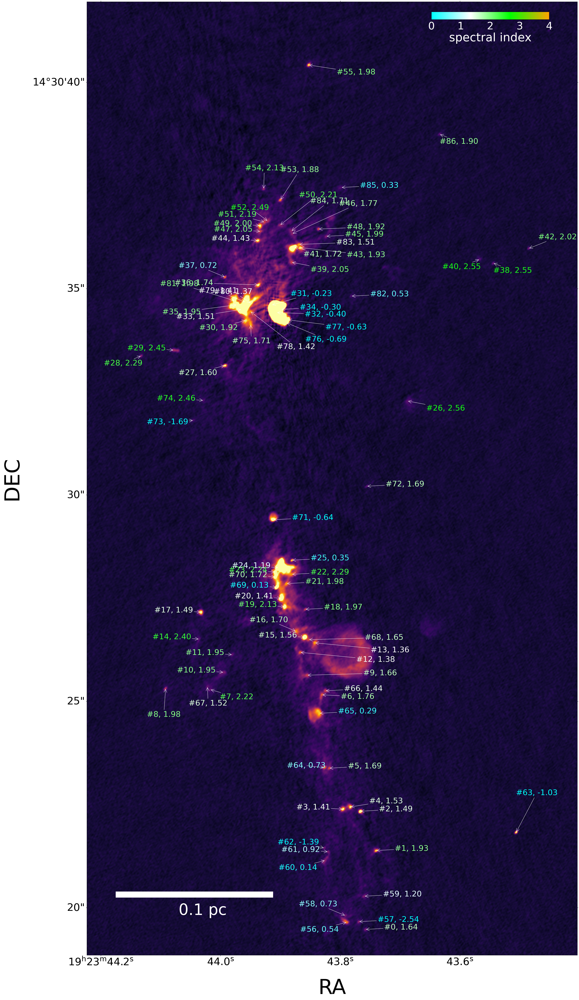

In [23]:
plt.style.use('default')
plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
fitsdata_b3 = fits.open(w51e_b3_tt0)
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0.15,0.15,0.85,0.85],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)
#mark_dendrogram_results(ax1, image, source_object,custom_dendro,
#                           vmin=-0.00044910456346381985,vfmax=0.006639306914117084)
#mark_dendrogram_results(ax1, imageb3_cut, source_object_b3,custom_dendro_b3
#                           ,vmin=-0.00044910456346381985,vmax=0.006639306914117084)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True,rejectreject=False)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True)

xpos = table_b3['x_pix_b3']
ypos = table_b3['y_pix_b3']
alpha_b3 = table_b3['alpha']
ismatched = table_b3['ismatched_b3']
m=plot_peak(ax1,imageb3,xpos,ypos,size=40,labelind=alpha_b3,xtextpos=xtextpos,ytextpos=ytextpos)

#plot_peak(ax1,imageb3,xpos_pix[ind3],ypos_pix[ind3],size=40,labelind=alpha_b6[ind3],xtextpos=xtextpos3,ytextpos=ytextpos3,boxcolor='cyan')
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
ax1.set_xlim(6600,8300)
ax1.set_ylim(5000,8300)


my_beamNB3 = Beam.from_fits_header(hdrNB3)
add_scale_bar(ax1, 6700,5200,0.1,scaleNB3,5.41e3,pad=-60,size=60)
#add_beam(ax1,6600,7100,my_beamNB3, scaleNB3)
axins1 = inset_axes(
    ax1,
    width="30%",  # width: 50% of parent_bbox width
    height="2%",  # height: 2%
    bbox_to_anchor=(0.7,0.98,0.8,0.4),
    bbox_transform=ax1.transAxes,loc=3,
)
print(len(xpos), len(np.where(ismatched==False)[0]), len(np.where(table_b6['ismatched_b6']==False)[0]))
cbar=plt.colorbar(m,cax=axins1,orientation='horizontal',ticks=[0,1,2,3,4])
plt.setp(plt.getp(cbar.ax.axes, 'xticklabels'), color='w')


cbar.set_label('spectral index',color='w',fontsize=45)
plt.savefig('dendroimage_w51e.png')

plt.show()

87 31 10


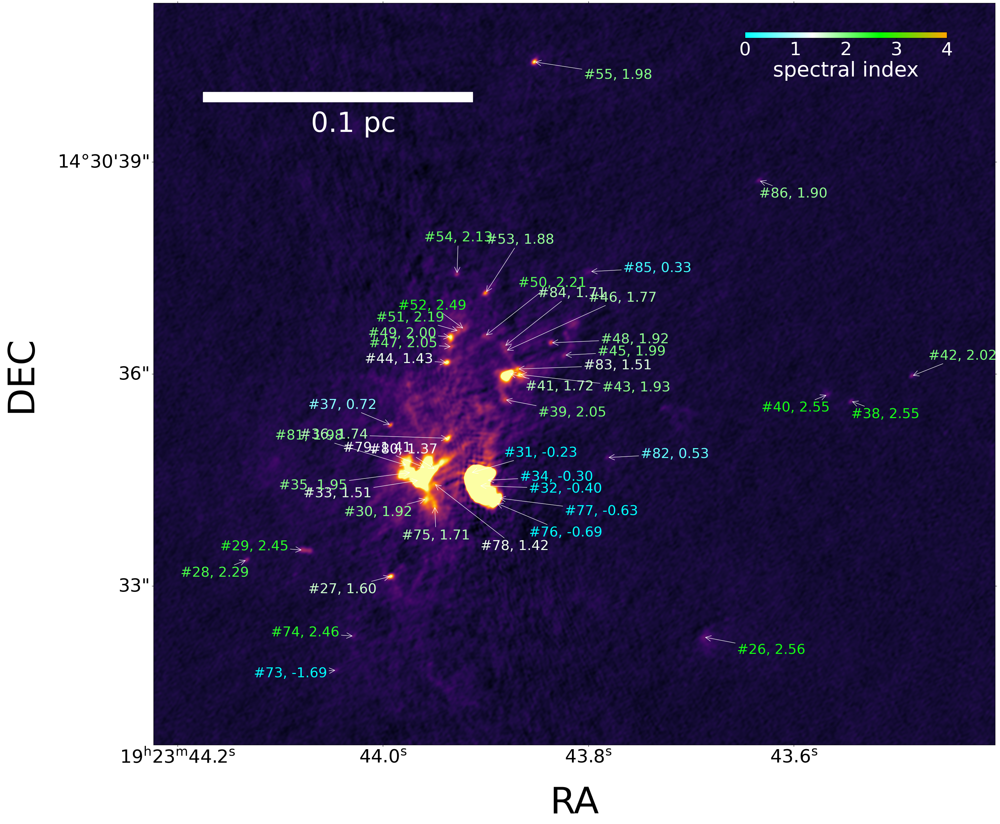

In [28]:
plt.style.use('default')
plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
fitsdata_b3 = fits.open(w51e_b3_tt0)
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.15,0.15,0.85,0.85],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)
#mark_dendrogram_results(ax1, image, source_object,custom_dendro,
#                           vmin=-0.00044910456346381985,vfmax=0.006639306914117084)
#mark_dendrogram_results(ax1, imageb3_cut, source_object_b3,custom_dendro_b3
#                           ,vmin=-0.00044910456346381985,vmax=0.006639306914117084)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True,rejectreject=False)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True)

xpos = table_b3['x_pix_b3']
ypos = table_b3['y_pix_b3']
alpha_b3 = table_b3['alpha']
ismatched = table_b3['ismatched_b3']
m=plot_peak(ax1,imageb3,xpos,ypos,size=40,labelind=alpha_b3,xtextpos=xtextpos,ytextpos=ytextpos)

#plot_peak(ax1,imageb3,xpos_pix[ind3],ypos_pix[ind3],size=40,labelind=alpha_b6[ind3],xtextpos=xtextpos3,ytextpos=ytextpos3,boxcolor='cyan')
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
ax1.set_xlim(6600,8300)
ax1.set_ylim(6700,8200)


my_beamNB3 = Beam.from_fits_header(hdrNB3)
add_scale_bar(ax1, 6700,8000,0.1,scaleNB3,5.41e3,pad=-60,size=60)
#add_beam(ax1,6600,7100,my_beamNB3, scaleNB3)
axins1 = inset_axes(
    ax1,
    width="30%",  # width: 50% of parent_bbox width
    height="2%",  # height: 2%
    bbox_to_anchor=(0.7,0.95,0.8,0.4),
    bbox_transform=ax1.transAxes,loc=3,
)
print(len(xpos), len(np.where(ismatched==False)[0]), len(np.where(table_b6['ismatched_b6']==False)[0]))
cbar=plt.colorbar(m,cax=axins1,orientation='horizontal',ticks=[0,1,2,3,4])
plt.setp(plt.getp(cbar.ax.axes, 'xticklabels'), color='w')


cbar.set_label('spectral index',color='w',fontsize=45)
plt.savefig('dendroimage_w51e2.png')

plt.show()

87 31 10


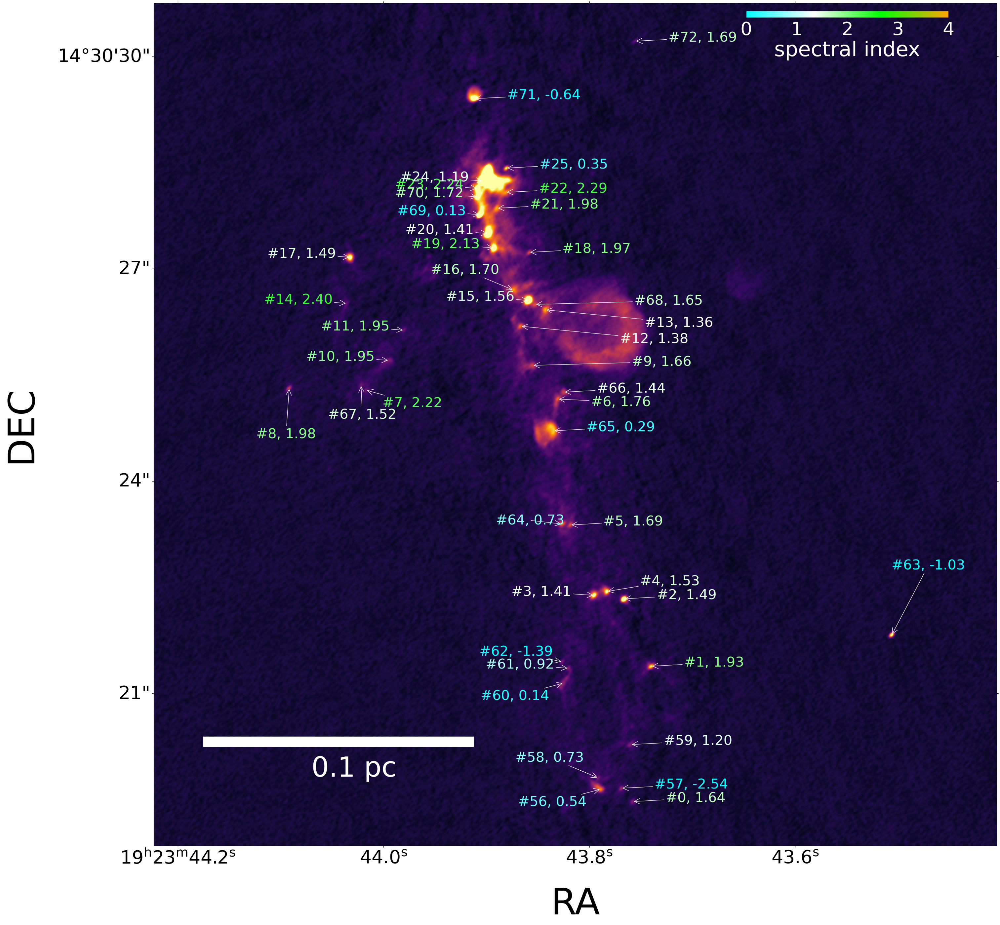

In [30]:
plt.style.use('default')
plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
fitsdata_b3 = fits.open(w51e_b3_tt0)
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0.15,0.15,0.85,0.85],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)
#mark_dendrogram_results(ax1, image, source_object,custom_dendro,
#                           vmin=-0.00044910456346381985,vfmax=0.006639306914117084)
#mark_dendrogram_results(ax1, imageb3_cut, source_object_b3,custom_dendro_b3
#                           ,vmin=-0.00044910456346381985,vmax=0.006639306914117084)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True,rejectreject=False)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True)

xpos = table_b3['x_pix_b3']
ypos = table_b3['y_pix_b3']
alpha_b3 = table_b3['alpha']
ismatched = table_b3['ismatched_b3']
m=plot_peak(ax1,imageb3,xpos,ypos,size=40,labelind=alpha_b3,xtextpos=xtextpos,ytextpos=ytextpos)

#plot_peak(ax1,imageb3,xpos_pix[ind3],ypos_pix[ind3],size=40,labelind=alpha_b6[ind3],xtextpos=xtextpos3,ytextpos=ytextpos3,boxcolor='cyan')
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
ax1.set_xlim(6600,8300)
ax1.set_ylim(5000,6700)


my_beamNB3 = Beam.from_fits_header(hdrNB3)
add_scale_bar(ax1, 6700,5200,0.1,scaleNB3,5.41e3,pad=-60,size=60)
#add_beam(ax1,6600,7100,my_beamNB3, scaleNB3)
axins1 = inset_axes(
    ax1,
    width="30%",  # width: 50% of parent_bbox width
    height="2%",  # height: 2%
    bbox_to_anchor=(0.7,0.98,0.8,0.4),
    bbox_transform=ax1.transAxes,loc=3,
)
print(len(xpos), len(np.where(ismatched==False)[0]), len(np.where(table_b6['ismatched_b6']==False)[0]))
cbar=plt.colorbar(m,cax=axins1,orientation='horizontal',ticks=[0,1,2,3,4])
plt.setp(plt.getp(cbar.ax.axes, 'xticklabels'), color='w')


cbar.set_label('spectral index',color='w',fontsize=45)
plt.savefig('dendroimage_w51e8.png')

plt.show()

In [ ]:
plt.style.use('default')

plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
import matplotlib as mpl 
import matplotlib.cm as cm
import matplotlib.colors
from matplotlib.patches import Rectangle, Ellipse

def plot_peak(ax,image,xpos,ypos,size=20,labelind=None,labeltext=None,xtextpos=None,ytextpos=None,boxcolor=None,mark=False):
    cmap = cm.YlGn
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ['cyan',"w","lime"])
    norm = mpl.colors.Normalize(vmin=0, vmax=4)
    
    
    if mark:
        ax.scatter(xpos,ypos, marker='x', c='cyan',s=size)
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    for i in range(len(labelind)):
        if boxcolor is not None:
            ax.annotate("#%d, %3.2f"%(i,labelind[i]),bbox=dict(facecolor='none',edgecolor=boxcolor),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
        else:
            
            ax.annotate("#%d, %3.2f"%(i,labelind[i]),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
    
    
def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+0.4*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))

xtextpos1 = np.array([100,100,100,-250,100,
100,100,0,-100,300,
-250,-250,300,300,-250,
-250,-250,-250,100,-250,
-250,100,100,-250,-250,
100,100,-250,-200,-250,
-250,100,150,-350,100,
-400,-450,-250,0,100,
-200,50,50,250,-250,
100,250,-250,150,-250,
100,-250,-200,0,-100,
150])
ytextpos1 = np.array([0,0,0,0,20,
0,-20,-50,-150,0,
0,-50,-50,-50,0,
0,50,0,0,0,
0,0,0,0,0,
0,-50,-50,-50,0,
-50,0,-50,-50,0,
0,0,50,-50,-50,
-50,-50,50,-50,0,
0,150,0,0,0,
150,30,60,150,100,
-50]
)

xtextpos2 = np.array([-250, 100, -250, 100, -250,
-250,-250,0,-200,100,
100,-100,300,-250,-250,
100,100,-250,-250,-100,
100,200,140,-250,-200,
-250,100,200,100,100,
0])
ytextpos2 = np.array([-50, 0, 50,0,-50,
0,20,200,0,0,
0,-100,0,0,0,
0,0,-20,0,-100,
-100,-50,-200,-100,50,
0,0,0,150,0,
-50]
)

xtextpos3 = np.array([-250,-250,-250,200,250,
100,100,90,-250,100])
ytextpos3 = np.array([0,0,0,50,0,
0,0,30,0,0])
    
fitsdata_b3 = fits.open(w51e_b3_tt0)
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(60,60))
ax1 = fig.add_axes([0,0,1,1],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)
#mark_dendrogram_results(ax1, image, source_object,custom_dendro,
#                           vmin=-0.00044910456346381985,vfmax=0.006639306914117084)
#mark_dendrogram_results(ax1, imageb3_cut, source_object_b3,custom_dendro_b3
#                           ,vmin=-0.00044910456346381985,vmax=0.006639306914117084)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True,rejectreject=False)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True)

xpos = table_b3['x_pix_b3']
ypos = table_b3['y_pix_b3']
alpha_b3 = table_b3['alpha']
ismatched = table_b3['ismatched_b3']
ind = np.where(ismatched==True)[0]
print(len(ind),len(xtextpos1))
plot_peak(ax1,imageb3,xpos[ind],ypos[ind],size=40,labelind=alpha_b3[ind],xtextpos=xtextpos1,ytextpos=ytextpos1)

ind2 = np.where(ismatched==False)[0]
print(len(ind2),len(xtextpos2))
plot_peak(ax1,imageb3,xpos[ind2],ypos[ind2],size=40,labelind=alpha_b3[ind2],xtextpos=xtextpos2,ytextpos=ytextpos2,boxcolor='r')
xpos = table_b6['x_sky_b6']
ypos = table_b6['y_sky_b6']
alpha_b6 = table_b6['alpha']
ismatched = table_b6['ismatched_b6']
xypos = np.vstack((xpos,ypos)).T
xypos_pix = wcsNB3.wcs_world2pix(xypos,0)
xpos_pix = xypos_pix[:,0]
ypos_pix = xypos_pix[:,1]

ind3 = np.where(ismatched==False)[0]
print(len(ind),len(xtextpos3))
plot_peak(ax1,imageb3,xpos_pix[ind3],ypos_pix[ind3],size=40,labelind=alpha_b6[ind3],xtextpos=xtextpos3,ytextpos=ytextpos3,boxcolor='cyan')
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
ax1.set_xlim(6600,8300)
ax1.set_ylim(5000,6700)
print(wcsNB3.pixel_to_world(6600,5000))
print(wcsNB3.pixel_to_world(8300,8300))

my_beamNB3 = Beam.from_fits_header(hdrNB3)
add_scale_bar(ax1, 7500,8200,0.1,scaleNB3,5.41e3,pad=-60)
#add_beam(ax1,6600,7100,my_beamNB3, scaleNB3)
plt.savefig('dendroimage_w51e8.png')

plt.show()




Text(0.5, 0, 'alpha')

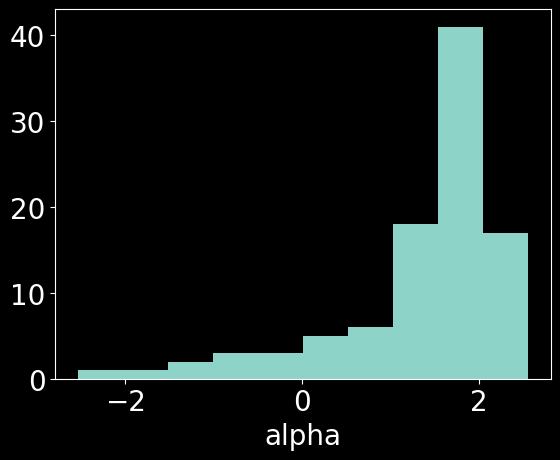

In [17]:
plt.rcParams['axes.labelsize']=20
plt.rcParams['xtick.labelsize']=20
plt.rcParams['ytick.labelsize']=20
plt.rcParams['axes.titlesize']=20
alpha = np.append(alpha_b3,alpha_b6[ind3])

plt.hist(alpha)
plt.xlabel('alpha')

56 56
31 31
56 10
<SkyCoord (ICRS): (ra, dec) in deg
    (290.93426385, 14.50854166)> <SkyCoord (ICRS): (ra, dec) in deg
    (290.93084939, 14.51145832)>


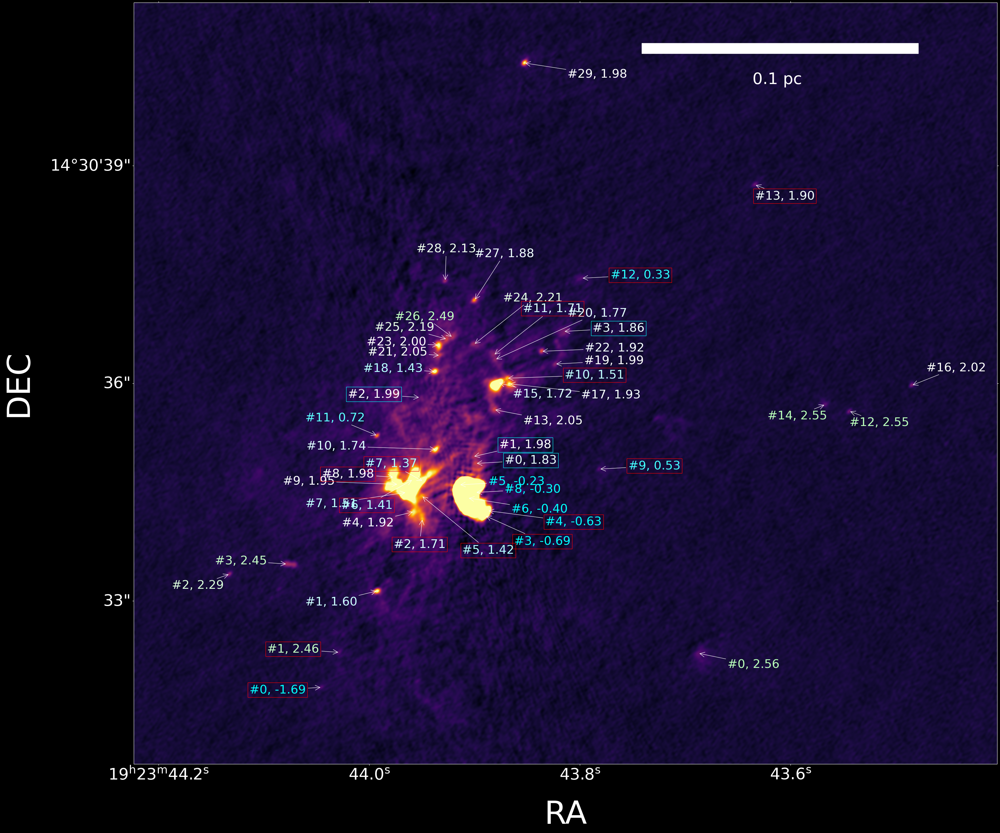

In [18]:
plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
import matplotlib as mpl 
import matplotlib.cm as cm
import matplotlib.colors
from matplotlib.patches import Rectangle, Ellipse

def plot_peak(ax,image,xpos,ypos,size=20,labelind=None,labeltext=None,xtextpos=None,ytextpos=None,boxcolor=None,mark=False):
    cmap = cm.YlGn
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ['cyan',"w","lime"])
    norm = mpl.colors.Normalize(vmin=0, vmax=4)
    
    
    if mark:
        ax.scatter(xpos,ypos, marker='x', c='cyan',s=size)
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    for i in range(len(labelind)):
        if boxcolor is not None:
            ax.annotate("#%d, %3.2f"%(i,labelind[i]),bbox=dict(facecolor='none',edgecolor=boxcolor),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
        else:
            
            ax.annotate("#%d, %3.2f"%(i,labelind[i]),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
    
    
def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+0.4*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))

xtextpos1 = np.array([100,100,100,-250,100,
100,100,0,-100,300,
-250,-250,300,300,-250,
-250,-250,-250,100,-250,
-250,100,100,-250,-250,
100,100,-250,-200,-250,
-250,100,150,-350,100,
-400,-450,-250,0,100,
-200,50,50,250,-250,
100,250,-250,150,-250,
100,-250,-200,0,-100,
150])
ytextpos1 = np.array([0,0,0,0,20,
0,-20,-50,-150,0,
0,-50,-50,-50,0,
0,50,0,0,0,
0,0,0,0,0,
0,-50,-50,-50,0,
-50,0,-50,-50,0,
0,0,50,-50,-50,
-50,-50,50,-50,0,
0,150,0,0,0,
150,30,60,150,100,
-50]
)

xtextpos2 = np.array([-250, 100, -250, 100, -250,
-250,-250,0,-200,100,
100,-100,300,-250,-250,
100,100,-250,-250,-100,
100,200,140,-250,-200,
-250,100,200,100,100,
0])
ytextpos2 = np.array([-50, 0, 50,0,-50,
0,20,200,0,0,
0,-100,0,0,0,
0,0,-20,0,-100,
-100,-50,-200,-100,50,
0,0,0,150,0,
-50]
)

xtextpos3 = np.array([-250,-250,-250,200,250,
100,100,90,-250,100])
ytextpos3 = np.array([0,0,0,50,0,
0,0,30,0,0])
    
fitsdata_b3 = fits.open(w51e_b3_tt0)
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0,0,1,1],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)
#mark_dendrogram_results(ax1, image, source_object,custom_dendro,
#                           vmin=-0.00044910456346381985,vfmax=0.006639306914117084)
#mark_dendrogram_results(ax1, imageb3_cut, source_object_b3,custom_dendro_b3
#                           ,vmin=-0.00044910456346381985,vmax=0.006639306914117084)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True,rejectreject=False)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True)

xpos = table_b3['x_pix_b3']
ypos = table_b3['y_pix_b3']
alpha_b3 = table_b3['alpha']
ismatched = table_b3['ismatched_b3']
ind = np.where(ismatched==True)[0]
print(len(ind),len(xtextpos1))
up = np.where(ypos[ind]>6700)[0]
plot_peak(ax1,imageb3,xpos[ind][up],ypos[ind][up],size=40,labelind=alpha_b3[ind][up],xtextpos=xtextpos1[up],ytextpos=ytextpos1[up])

ind2 = np.where(ismatched==False)[0]
print(len(ind2),len(xtextpos2))
up = np.where(ypos[ind2]>6700)[0]

plot_peak(ax1,imageb3,xpos[ind2][up],ypos[ind2][up],size=40,labelind=alpha_b3[ind2][up],xtextpos=xtextpos2[up],ytextpos=ytextpos2[up],boxcolor='r')
xpos = table_b6['x_sky_b6']
ypos = table_b6['y_sky_b6']
alpha_b6 = table_b6['alpha']
ismatched = table_b6['ismatched_b6']
xypos = np.vstack((xpos,ypos)).T
xypos_pix = wcsNB3.wcs_world2pix(xypos,0)
xpos_pix = xypos_pix[:,0]
ypos_pix = xypos_pix[:,1]

ind3 = np.where(ismatched==False)[0]
print(len(ind),len(xtextpos3))
up = np.where(ypos_pix[ind3]>6700)[0]
plot_peak(ax1,imageb3,xpos_pix[ind3][up],ypos_pix[ind3][up],size=40,labelind=alpha_b6[ind3][up],xtextpos=xtextpos3[up],ytextpos=ytextpos3[up],boxcolor='cyan')
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
ax1.set_xlim(6600,8300)
ax1.set_ylim(6700,8200)

sky1 = wcsNB3.pixel_to_world(6600,6700)
sky2 = wcsNB3.pixel_to_world(8300,8200)
print(sky1,sky2)
my_beamNB3 = Beam.from_fits_header(hdrNB3)
add_scale_bar(ax1, 7600,8100,0.1,scaleNB3,5.41e3,pad=-60)
#add_beam(ax1,6600,7100,my_beamNB3, scaleNB3)
plt.savefig('dendroimage_w51e2.png')

plt.show()




56 56
31 31
56 10


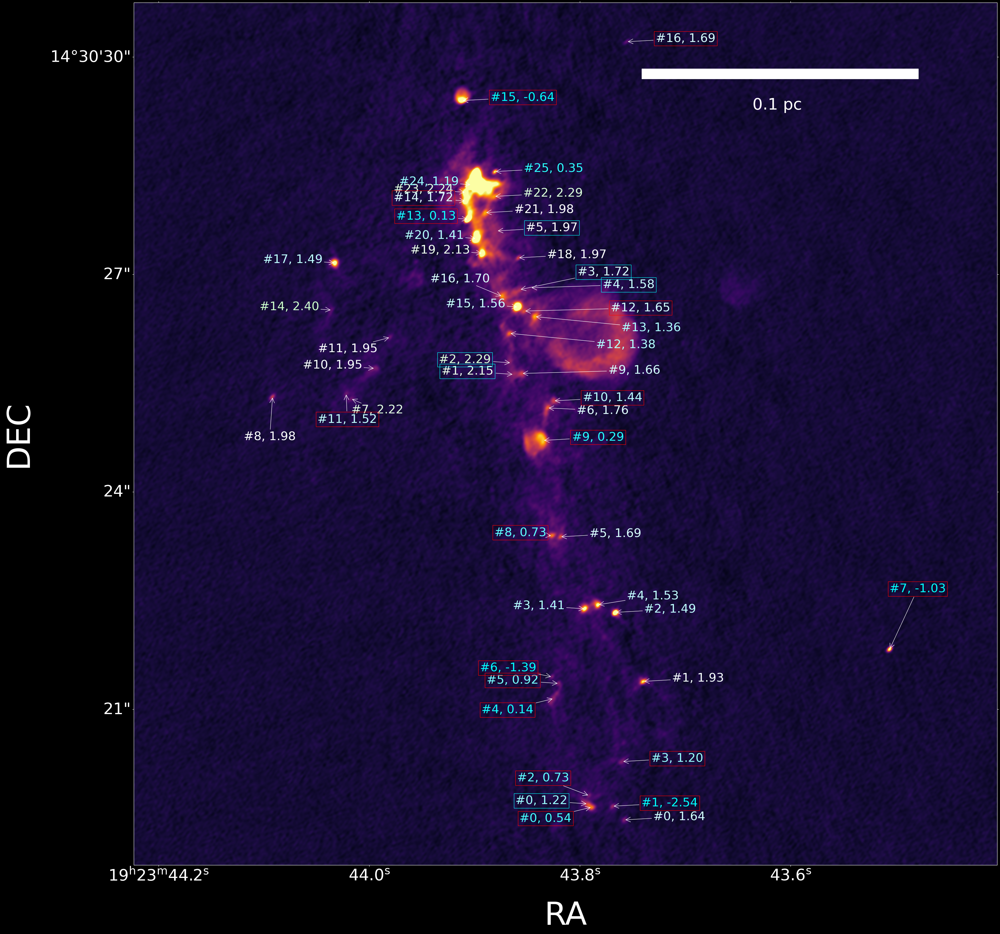

<SkyCoord (ICRS): (ra, dec) in deg
    (290.93426384, 14.50523611)> <SkyCoord (ICRS): (ra, dec) in deg
    (290.93084941, 14.50854166)>


In [19]:
plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
import matplotlib as mpl 
import matplotlib.cm as cm
import matplotlib.colors
from matplotlib.patches import Rectangle, Ellipse

def plot_peak(ax,image,xpos,ypos,size=20,labelind=None,labeltext=None,xtextpos=None,ytextpos=None,boxcolor=None,mark=False):
    cmap = cm.YlGn
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ['cyan',"w","lime"])
    norm = mpl.colors.Normalize(vmin=0, vmax=4)
    
    
    if mark:
        ax.scatter(xpos,ypos, marker='x', c='cyan',s=size)
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    for i in range(len(labelind)):
        if boxcolor is not None:
            ax.annotate("#%d, %3.2f"%(i,labelind[i]),bbox=dict(facecolor='none',edgecolor=boxcolor),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
        else:
            
            ax.annotate("#%d, %3.2f"%(i,labelind[i]),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
    
    
def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+0.4*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))

xtextpos1 = np.array([100,100,100,-250,100,
100,100,0,-100,300,
-250,-250,300,300,-250,
-250,-250,-250,100,-250,
-250,100,100,-250,-250,
100,100,-250,-200,-250,
-250,100,150,-350,100,
-400,-450,-250,0,100,
-200,50,50,250,-250,
100,250,-250,150,-250,
100,-250,-200,0,-100,
150])
ytextpos1 = np.array([0,0,0,0,20,
0,-20,-50,-150,0,
0,-50,-50,-50,0,
0,50,0,0,0,
0,0,0,0,0,
0,-50,-50,-50,0,
-50,0,-50,-50,0,
0,0,50,-50,-50,
-50,-50,50,-50,0,
0,150,0,0,0,
150,30,60,150,100,
-50]
)

xtextpos2 = np.array([-250, 100, -250, 100, -250,
-250,-250,0,-200,100,
100,-100,300,-250,-250,
100,100,-250,-250,-100,
100,200,140,-250,-200,
-250,100,200,100,100,
0])
ytextpos2 = np.array([-50, 0, 50,0,-50,
0,20,200,0,0,
0,-100,0,0,0,
0,0,-20,0,-100,
-100,-50,-200,-100,50,
0,0,0,150,0,
-50]
)

xtextpos3 = np.array([-250,-250,-250,200,250,
100,100,90,-250,100])
ytextpos3 = np.array([0,0,0,50,0,
0,0,30,0,0])
    
fitsdata_b3 = fits.open(w51e_b3_tt0)
hdrNB3 = fits.getheader(w51e_b3_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0,0,1,1],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)
#mark_dendrogram_results(ax1, image, source_object,custom_dendro,
#                           vmin=-0.00044910456346381985,vfmax=0.006639306914117084)
#mark_dendrogram_results(ax1, imageb3_cut, source_object_b3,custom_dendro_b3
#                           ,vmin=-0.00044910456346381985,vmax=0.006639306914117084)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True,rejectreject=False)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True)

xpos = table_b3['x_pix_b3']
ypos = table_b3['y_pix_b3']
alpha_b3 = table_b3['alpha']
ismatched = table_b3['ismatched_b3']
ind = np.where(ismatched==True)[0]
print(len(ind),len(xtextpos1))
down = np.where(ypos[ind]<6700)[0]
plot_peak(ax1,imageb3,xpos[ind][down],ypos[ind][down],size=40,labelind=alpha_b3[ind][down],xtextpos=xtextpos1[down],ytextpos=ytextpos1[down])

ind2 = np.where(ismatched==False)[0]
print(len(ind2),len(xtextpos2))
down = np.where(ypos[ind2]<6700)[0]

plot_peak(ax1,imageb3,xpos[ind2][down],ypos[ind2][down],size=40,labelind=alpha_b3[ind2][down],xtextpos=xtextpos2[down],ytextpos=ytextpos2[down],boxcolor='r')
xpos = table_b6['x_sky_b6']
ypos = table_b6['y_sky_b6']
alpha_b6 = table_b6['alpha']
ismatched = table_b6['ismatched_b6']
xypos = np.vstack((xpos,ypos)).T
xypos_pix = wcsNB3.wcs_world2pix(xypos,0)
xpos_pix = xypos_pix[:,0]
ypos_pix = xypos_pix[:,1]

ind3 = np.where(ismatched==False)[0]
print(len(ind),len(xtextpos3))
down = np.where(ypos_pix[ind3]<6700)[0]
plot_peak(ax1,imageb3,xpos_pix[ind3][down],ypos_pix[ind3][down],size=40,labelind=alpha_b6[ind3][down],xtextpos=xtextpos3[down],ytextpos=ytextpos3[down],boxcolor='cyan')
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
ax1.set_xlim(6600,8300)
ax1.set_ylim(5000,6700)
my_beamNB3 = Beam.from_fits_header(hdrNB3)
add_scale_bar(ax1, 7600,6550,0.1,scaleNB3,5.41e3,pad=-60)
#add_beam(ax1,6600,7100,my_beamNB3, scaleNB3)
plt.savefig('dendroimage_w51e8.png')

plt.show()

sky1 = wcsNB3.pixel_to_world(6600,5000)
sky2 = wcsNB3.pixel_to_world(8300,6700)
print(sky1,sky2)


In [20]:
plt.rcParams['axes.labelsize']=80
plt.rcParams['xtick.labelsize']=40
plt.rcParams['ytick.labelsize']=40
plt.rcParams['axes.titlesize']=80
import matplotlib as mpl 
import matplotlib.cm as cm
import matplotlib.colors
from matplotlib.patches import Rectangle, Ellipse

def plot_peak(ax,image,xpos,ypos,size=20,labelind=None,labeltext=None,xtextpos=None,ytextpos=None,boxcolor=None,mark=False):
    cmap = cm.YlGn
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ['cyan',"w","lime"])
    norm = mpl.colors.Normalize(vmin=0, vmax=4)
    
    
    if mark:
        ax.scatter(xpos,ypos, marker='x', c='cyan',s=size)
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    for i in range(len(labelind)):
        if boxcolor is not None:
            ax.annotate("#%d, %3.2f"%(i,labelind[i]),bbox=dict(facecolor='none',edgecolor=boxcolor),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
        else:
            
            ax.annotate("#%d, %3.2f"%(i,labelind[i]),xy=(xpos[i],ypos[i]), xycoords='data', textcoords='offset pixels',
                    arrowprops=dict(arrowstyle="->",ec='w',fc='w'),xytext=(xtextpos[i],ytextpos[i]),fontsize=30,color=m.to_rgba(labelind[i]))
    
    
def add_scale_bar(ax, xpos,ypos,scale, pixel_scale, dist, unit='pc',height=20,color='w',pad=40,size=40):
    phy_pix_scale = pixel_scale.value * np.pi/180 * dist
    ax.add_patch(Rectangle((xpos,ypos),scale/phy_pix_scale,height,color=color))
    ax.text(xpos+0.4*scale/phy_pix_scale, ypos+pad, '%2.1f %s'%(scale, unit), color=color,fontsize=size)
                
def add_beam(ax,xpos,ypos,beam, pixel_scale,color='w'):
    width = beam.major / pixel_scale
    height = beam.minor /pixel_scale
    angle = beam.pa
    ax.add_patch(Ellipse((xpos,ypos),width.value,height.value,180-angle.value,color=color))

xtextpos1 = np.array([100,100,100,-250,100,
100,100,0,-100,300,
-250,-250,300,300,-250,
-250,-250,-250,100,-250,
-250,100,100,-250,-250,
100,100,-250,-200,-250,
-250,100,150,-350,100,
-400,-450,-250,0,100,
-200,50,50,250,-250,
100,250,-250,150,-250,
100,-250,-200,0,-100,
150])
ytextpos1 = np.array([0,0,0,0,20,
0,-20,-50,-150,0,
0,-50,-50,-50,0,
0,50,0,0,0,
0,0,0,0,0,
0,-50,-50,-50,0,
-50,0,-50,-50,0,
0,0,50,-50,-50,
-50,-50,50,-50,0,
0,150,0,0,0,
150,30,60,150,100,
-50]
)

xtextpos2 = np.array([-250, 100, -250, 100, -250,
-250,-250,0,-200,100,
100,-100,300,-250,-250,
100,100,-250,-250,-100,
100,200,140,-250,-200,
-250,100,200,100,100,
0])
ytextpos2 = np.array([-50, 0, 50,0,-50,
0,20,200,0,0,
0,-100,0,0,0,
0,0,-20,0,-100,
-100,-50,-200,-100,50,
0,0,0,150,0,
-50]
)

xtextpos3 = np.array([-250,-250,-250,200,250,
100,100,90,-250,100])
ytextpos3 = np.array([0,0,0,50,0,
0,0,30,0,0])
    
fitsdata_b3 = fits.open(w51e_b6_tt0)
hdrNB3 = fits.getheader(w51e_b6_tt0)  
wcsNB3 = WCS(hdrNB3,naxis=2)
scaleNB3 = wcsNB3.proj_plane_pixel_scales()[0]
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_axes([0,0,1,1],projection=wcsNB3)
imageb3 = fitsdata_b3[0].data[0][0]
ax1.imshow(imageb3, origin='lower',cmap=plt.get_cmap('inferno'),vmin=-0.00010907209521789237,vmax=0.0010342193801073328)
#mark_dendrogram_results(ax1, image, source_object,custom_dendro,
#                           vmin=-0.00044910456346381985,vfmax=0.006639306914117084)
#mark_dendrogram_results(ax1, imageb3_cut, source_object_b3,custom_dendro_b3
#                           ,vmin=-0.00044910456346381985,vmax=0.006639306914117084)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True,rejectreject=False)
#draw_sources_ellipses(ax1,wcs,source_object.pixel_scale,source_object,lw=1,markname=True)

xpos = table_b3['x_pix_b6']
ypos = table_b3['y_pix_b6']
alpha_b3 = table_b3['alpha']
ismatched = table_b3['ismatched_b6']
ind = np.where(ismatched==True)[0]
print(len(ind),len(xtextpos1))
up = np.where(ypos[ind]>5400)[0]
plot_peak(ax1,imageb3,xpos[ind][up],ypos[ind][up],size=40,labelind=alpha_b3[ind][up],xtextpos=xtextpos1[up],ytextpos=ytextpos1[up])

ind2 = np.where(ismatched==False)[0]
print(len(ind2),len(xtextpos2))
up = np.where(ypos[ind2]>5400)[0]

plot_peak(ax1,imageb3,xpos[ind2][up],ypos[ind2][up],size=40,labelind=alpha_b3[ind2][up],xtextpos=xtextpos2[up],ytextpos=ytextpos2[up],boxcolor='r')
xpos = table_b6['x_sky_b3']
ypos = table_b6['y_sky_b3']
alpha_b6 = table_b6['alpha']
ismatched = table_b6['ismatched_b3']
xypos = np.vstack((xpos,ypos)).T
xypos_pix = wcsNB3.wcs_world2pix(xypos,0)
xpos_pix = xypos_pix[:,0]
ypos_pix = xypos_pix[:,1]

ind3 = np.where(ismatched==False)[0]
print(len(ind),len(xtextpos3))
up = np.where(ypos_pix[ind3]>5400)[0]
plot_peak(ax1,imageb3,xpos_pix[ind3][up],ypos_pix[ind3][up],size=40,labelind=alpha_b6[ind3][up],xtextpos=xtextpos3[up],ytextpos=ytextpos3[up],boxcolor='cyan')
ax1.set_xlabel('RA')
ax1.set_ylabel('DEC')
ax1.set_xlim(5200,7200)
ax1.set_ylim(5400,7200)

sky1 = wcsNB3.pixel_to_world(5200,5400)
sky2 = wcsNB3.pixel_to_world(7200,7200)
print(sky1,sky2)
my_beamNB3 = Beam.from_fits_header(hdrNB3)
add_scale_bar(ax1, 7000,7100,0.1,scaleNB3,5.41e3,pad=-60)
#add_beam(ax1,6600,7100,my_beamNB3, scaleNB3)
plt.savefig('dendroimage_w51e2.png')

plt.show()




NameError: name 'w51e_b6_tt0' is not defined